# Coronvirus_Analysis

#### Analysis of Coronavirus (COVID-19) Evolution and Impact

## 1 Import, clean and format confirmed Cases

### 1.1 Data Sources

#### Source of data: https://raw.githubusercontent.com/CSSEGISandData, this is updated by John Hopkins Univiersity from a variety of government and NGO sources
#### For full list of sources see: https://systems.jhu.edu/research/public-health/ncov/
#### originally had been pulling directly from google sheets as per

#### csv_url='http://spreadsheets.google.com/ccc?key=1UF2pSkFTURko2OvfHWWlFpDFAr1UxCBA4JLwlSP6KFo&output=csv'



In [1]:


import pandas as pd
import numpy as np
import requests as rs
import pandas as pd

csv_url = 'https://raw.githubusercontent.com/CSSEGISandData/COVID-19/master/csse_covid_19_data/csse_covid_19_time_series/time_series_covid19_confirmed_global.csv'

res=rs.get(url=csv_url)
open('coronavirus_stats_conf3.csv', 'wb').write(res.content)

#read_conf = pd.read_csv('/Users/neil.watt/Documents/PythonScripts/Coronavirus/coronavirus_stats_conf2.csv', encoding = "ISO-8859-1")



204345

In [2]:
#read_conf = pd.read_csv('/Users/neilwatt/Documents/Projects/Coronavirus/Coronavirus_Analysis/coronavirus_stats_conf3.csv', encoding = "ISO-8859-1")
read_conf = pd.read_csv('/Users/neil.watt/Documents/PythonScripts/Coronavirus/coronavirus_stats_conf3.csv', encoding = "ISO-8859-1")
#replace blank province/state with nil
read_conf['Province/State'].fillna('', inplace=True)

#replace all other NaNs with 0
read_conf.fillna(0, inplace=True)

#create new name key column
read_conf.insert(1, 'name', read_conf["Province/State"].map(str) +' '+ read_conf["Country/Region"])



### 1.2 Formatting and Cleaning Data

#### The data in the CSV file needs to be re-worked and reshaped to facilitate convenient plotting.
#### 1.  I first sliced the csv into two dataframes and then transposed the date columns (from column 5 onwards)
#### 2. Next step was to rework the cases figures into a "Cases" column according to the Date column (which is created from the index date)

In [3]:


#slice confirmed cases into two dfs in order to recombine transpose of the cases table with the regions

read_conf_copy=read_conf.copy()

#this creates a dataframe which is a slice with just the city rows (which will be replciated for each date)

new_city=read_conf_copy.iloc[:,0:5]
read_conf_copy=read_conf.copy()

#this slices the date columns from the original

#new_df2=read_conf_copy.iloc[:,6:]
new_df2=read_conf_copy.iloc[:,5:]



#transpose date and cases columnes
new_df2_T=new_df2.T


#number cities
i_points=len(read_conf.index)

#new_df2_T_1=new_df2_T.iloc[:,0:1]
new_df2_T['Date'] = new_df2_T.index

d = {}
for i in range (0,i_points):
    d[i]=new_df2_T.iloc[:,i].to_frame()
    d[i].rename(columns={ d[i].columns[0]: "Cases" }, inplace = True)
    d[i]['Date'] = d[i].index
    
   


#### Dataframes are subsequently re-combined and duplicates are eliminated

In [4]:

#recombine dataframes

dfs={}
for i in range (0,i_points):


#match with df1 based on column header
    city_row=new_city.loc[i,:].to_frame()
    city_row_T=city_row.T

#needs to be repeated same number of times as date columns
    n_times=len(d[i].index)
    city_row_T2=pd.concat([city_row_T]*n_times)


    d[i]['tmp'] = 1
    city_row_T2['tmp'] = 1

    dfs[i] = pd.merge(city_row_T2,d[i], on=['tmp'])
    dfs[i] = dfs[i].drop('tmp', axis=1)
    dfs[i]= dfs[i].drop_duplicates(subset='Date')







In [5]:


#append dataframes into master format
from datetime import datetime


final_df = pd.concat(dfs, ignore_index=True)
#in order to model number of days from onset, convert to datetime
final_df['Date_proper'] = pd.to_datetime(final_df['Date'])

#Create new days column based on number of days from first row
final_df['Day']=((final_df['Date_proper']-final_df['Date_proper'].iloc[0]).dt.total_seconds())/(24*60*60)+1


final_df['Delta_Cases']=final_df['Cases'].groupby(final_df['name']).diff()

final_df['Delta_Cases7']=final_df.Delta_Cases.rolling(7).mean()

final_df['Acceleration']=final_df['Delta_Cases'].groupby(final_df['name']).diff()

#7 day average acceleration
final_df['Acceleration7'] = final_df.Acceleration.rolling(7).mean()

final_df.to_csv(r'Coronavirus_cases_cleaned.csv')

In [6]:

#exlcude Mainland China cases for international cases
final_df_international=final_df[final_df['Country/Region']!='China']


#mainland china df
final_df_MChina=final_df[final_df['Country/Region']=='China']

#mainland exlcuding Hubei
final_df_MChina_exHubei=final_df_MChina[final_df_MChina['Province/State']!='Hubei']




### Defining Dataframes

In [7]:

### adding top regions by number of cases for further analysis


#hubei
final_df_MChina_Hubei=final_df_MChina[final_df_MChina['Province/State']=='Hubei']

#Guangdong
final_df_MChina_Guangdong=final_df_MChina[final_df_MChina['Province/State']=='Guangdong']
#Zhejiang
final_df_MChina_Zhejiang=final_df_MChina[final_df_MChina['Province/State']=='Zhejiang']
#Henan
final_df_MChina_Henan=final_df_MChina[final_df_MChina['Province/State']=='Henan']

#Hunan
final_df_MChina_Hunan=final_df_MChina[final_df_MChina['Province/State']=='Hunan']

#Anhui
final_df_MChina_Anhui=final_df_MChina[final_df_MChina['Province/State']=='Anhui']


#Jiangxi
final_df_MChina_Jiangxi=final_df_MChina[final_df_MChina['Province/State']=='Jiangxi']

## Plotting Cases by Geography

In [8]:
import  plotly.express as px
#https://plot.ly/python-api-reference/generated/plotly.express.scatter_geo.html
scale=0.1




fig = px.scatter_geo(final_df_MChina , lat="Lat",lon="Long",
                    color="Cases",
                    #size="Cases",
                     size_max=70,
                    size='Cases',
                     #size="Cases",
                     title="Coronavirus Cases by Day (Mainland China))",
                     
                   hover_name="name", 
                     #labels="name",
                    color_continuous_scale=px.colors.sequential.RdBu[::-1],
                     # color_continuous_scale=px.colors.sequential.Plasma,
                     #plotly.express.colors.diverging
                    animation_frame="Date"
                    
                    
                    )
fig.show()

In [9]:

# plot of international cases

import plotly.express as px


fig = px.line(final_df_international,title="International Cases", x="Date", y="Cases", color="name", line_group="name", hover_name="name",render_mode="svg")
fig.for_each_trace(lambda t: t.update(name=t.name.replace("name=", "")))
fig.show()

In [10]:

df_italy=final_df_international[final_df_international['Country/Region']=='Italy']
                                
df_italy.head()

,Province/State,name,Country/Region,Lat,Long,Cases,Date,Date_proper,Day,Delta_Cases,Delta_Cases7,Acceleration,Acceleration7
26715,,Italy,Italy,41.8719,12.5674,0,1/22/20,2020-01-22,1.0,NaN,NaN,NaN,NaN
26716,,Italy,Italy,41.8719,12.5674,0,1/23/20,2020-01-23,2.0,0.0,NaN,NaN,NaN
26717,,Italy,Italy,41.8719,12.5674,0,1/24/20,2020-01-24,3.0,0.0,NaN,0.0,NaN
26718,,Italy,Italy,41.8719,12.5674,0,1/25/20,2020-01-25,4.0,0.0,NaN,0.0,NaN
26719,,Italy,Italy,41.8719,12.5674,0,1/26/20,2020-01-26,5.0,0.0,NaN,0.0,NaN


In [11]:
final_df_MChina.head()

,Province/State,name,Country/Region,Lat,Long,Cases,Date,Date_proper,Day,Delta_Cases,Delta_Cases7,Acceleration,Acceleration7
9555,Anhui,Anhui China,China,31.8257,117.226,1,1/22/20,2020-01-22,1.0,NaN,NaN,NaN,NaN
9556,Anhui,Anhui China,China,31.8257,117.226,9,1/23/20,2020-01-23,2.0,8.0,NaN,NaN,NaN
9557,Anhui,Anhui China,China,31.8257,117.226,15,1/24/20,2020-01-24,3.0,6.0,NaN,-2.0,NaN
9558,Anhui,Anhui China,China,31.8257,117.226,39,1/25/20,2020-01-25,4.0,24.0,NaN,18.0,NaN
9559,Anhui,Anhui China,China,31.8257,117.226,60,1/26/20,2020-01-26,5.0,21.0,NaN,-3.0,NaN


In [12]:
#non Mainland China only

import  plotly.express as px
#https://plot.ly/python-api-reference/generated/plotly.express.scatter_geo.html


final_df_US_specific=final_df[(final_df['Country/Region']=='US') ]


fig = px.scatter_geo(final_df_US_specific , lat="Lat",lon="Long",
                    color="Cases",
                    #size="Cases",
                     size_max=40,
                    size='Cases',
                     #size="Cases",
                     title="Coronavirus Cases by Day (U.S))",
                     
                   hover_name="name", 
                     #labels="name",
                  #  color_continuous_scale=px.colors.sequential.RdBu[::-1],
                    # color_continuous_scale=px.colors.sequential.RdBu[::-1],
                     # color_continuous_scale=px.colors.sequential.Plasma,
                     #plotly.express.colors.diverging
                    animation_frame="Date"
                   
                    
                    
                    )
fig.show()

In [13]:
df_top=final_df_international[final_df_international['Country/Region'].isin(['Republic of Korea','Italy','Iran (Islamic Republic of)','Japan','France','Germany','Spain'
,'Singapore'
,'Hong Kong'
,'Kuwait'
,'Switzerland'
,'UK'
])]
df_top.head()

      
      

,Province/State,name,Country/Region,Lat,Long,Cases,Date,Date_proper,Day,Delta_Cases,Delta_Cases7,Acceleration,Acceleration7
20865,French Guiana,French Guiana France,France,3.9339,-53.1258,0,1/22/20,2020-01-22,1.0,NaN,NaN,NaN,NaN
20866,French Guiana,French Guiana France,France,3.9339,-53.1258,0,1/23/20,2020-01-23,2.0,0.0,NaN,NaN,NaN
20867,French Guiana,French Guiana France,France,3.9339,-53.1258,0,1/24/20,2020-01-24,3.0,0.0,NaN,0.0,NaN
20868,French Guiana,French Guiana France,France,3.9339,-53.1258,0,1/25/20,2020-01-25,4.0,0.0,NaN,0.0,NaN
20869,French Guiana,French Guiana France,France,3.9339,-53.1258,0,1/26/20,2020-01-26,5.0,0.0,NaN,0.0,NaN


#### International Cases 

In [14]:
final_df_international=final_df[final_df['Country/Region']!='China']




In [15]:
# plot of ex Mainland cases (total)


#exlcude Mainland China cases for international cases
#final_df_international=final_df[final_df['Country/Region']!='Mainland China']

final_df_international['total_cases']=final_df_international['Cases'].groupby(final_df_international['Date']).transform('sum')




#df_international=final_df_international[final_df_international['Country/Region'].isin(['South Korea','Italy','Iran','Japan','France','Germany','Spain'

           
#df_international=df[-df["column"].isin(["value"])]
                                                                                    

C:\Users\neil.watt\AppData\Local\Continuum\anaconda3\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy



In [16]:

import plotly.express as px


fig = px.line(final_df_international,title="International Cases outside Mainland China", x="Date", y="total_cases", color="name", line_group="name", render_mode="svg")
fig.for_each_trace(lambda t: t.update(name=t.name.replace("name=", "")))
fig.show()

### Euro

In [17]:
final_df_international['total_cases']=final_df_international['Cases'].groupby(final_df_international['Date']).transform('sum')
final_df_international

C:\Users\neil.watt\AppData\Local\Continuum\anaconda3\lib\site-packages\ipykernel_launcher.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy



,Province/State,name,Country/Region,Lat,Long,Cases,Date,Date_proper,Day,Delta_Cases,Delta_Cases7,Acceleration,Acceleration7,total_cases
0,,Afghanistan,Afghanistan,33.9391,67.71,0,1/22/20,2020-01-22,1.0,NaN,NaN,NaN,NaN,7
1,,Afghanistan,Afghanistan,33.9391,67.71,0,1/23/20,2020-01-23,2.0,0.0,NaN,NaN,NaN,11
2,,Afghanistan,Afghanistan,33.9391,67.71,0,1/24/20,2020-01-24,3.0,0.0,NaN,0.0,NaN,21
3,,Afghanistan,Afghanistan,33.9391,67.71,0,1/25/20,2020-01-25,4.0,0.0,NaN,0.0,NaN,28
4,,Afghanistan,Afghanistan,33.9391,67.71,0,1/26/20,2020-01-26,5.0,0.0,NaN,0.0,NaN,43
5,,Afghanistan,Afghanistan,33.9391,67.71,0,1/27/20,2020-01-27,6.0,0.0,NaN,0.0,NaN,50
6,,Afghanistan,Afghanistan,33.9391,67.71,0,1/28/20,2020-01-28,7.0,0.0,NaN,0.0,NaN,69
7,,Afghanistan,Afghanistan,33.9391,67.71,0,1/29/20,2020-01-29,8.0,0.0,0.000000,0.0,NaN,79
8,,Afghanistan,Afghanistan,33.9391,67.71,0,1/30/20,2020-01-30,9.0,0.0,0.000000,0.0,0.000000,93
9,,Afghanistan,Afghanistan,33.9391,67.71,0,1/31/20,2020-01-31,10.0,0.0,0.000000,0.0,0.000000,125


In [18]:
  

#filter out double France and UK cases

Euro_list=[' Austria', ' Belgium', ' Bosnia and Herzegovina', ' Cyprus', ' Czech Republic', ' Denmark', ' Finland', ' France', ' Germany', ' Gibraltar', ' Hungary', ' Iceland', ' Ireland', ' Italy', ' Malta', ' Netherlands', ' Norway', ' Poland', ' Portugal', ' Spain', ' Sweden', ' Switzerland', ' United Kingdom', ' Albania', ' Bulgaria', ' Channel Islands', ' Faroe Islands', ' Greece', ' Liechtenstein', ' North Macedonia', ' Romania'

]

final_df_Euro=final_df_international[final_df_international['name'].isin(Euro_list)]
final_df_Euro['total_cases']=final_df_Euro['Cases'].groupby(final_df_Euro['Date']).transform('sum')




C:\Users\neil.watt\AppData\Local\Continuum\anaconda3\lib\site-packages\ipykernel_launcher.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy



In [19]:
import plotly.express as px


fig = px.line(final_df_Euro,title="Euro Cases", x="Date", y="total_cases", color="name", line_group="name", render_mode="svg")
fig.for_each_trace(lambda t: t.update(name=t.name.replace("name=", "")))
fig.show()

In [20]:
## plot of Euro cases by country





import plotly.express as px


fig = px.line(final_df_Euro,title="Euro Cases", x="Date", y="Cases", color="name", line_group="name", hover_name="name",render_mode="svg")
fig.for_each_trace(lambda t: t.update(name=t.name.replace("name=", "")))
fig.show()

In [21]:
#Euro Delta_Cases



import plotly.express as px


fig = px.line(final_df_Euro,title="Day on Day Delta Euro Cases", x="Date", y="Delta_Cases", color="name", line_group="name", hover_name="name",render_mode="svg")
fig.for_each_trace(lambda t: t.update(name=t.name.replace("name=", "")))
fig.show()

In [22]:
# define UK dataframe

UK_list=[ 'United Kingdom United Kingdom']




final_df_UK=final_df_international[final_df_international['name'].isin(UK_list)]

#filter out double France and UK cases




final_df_UK['total_cases']=final_df_UK['Cases'].groupby(final_df_UK['Date']).transform('sum')

In [23]:
## plot of UK cases



UK_list=[  ' United Kingdom']




final_df_UK=final_df_international[final_df_international['name'].isin(UK_list)]

#filter out double France and UK cases







import plotly.express as px


fig = px.line(final_df_UK,title="New Covid-19 Cases (UK)", x="Date", y="Delta_Cases", color="name", line_group="name", hover_name="name",render_mode="svg")
fig.for_each_trace(lambda t: t.update(name=t.name.replace("name=", "")))
fig.show()

In [24]:
## plot of US cases



US_list=[  ' US']




final_df_US=final_df_international[final_df_international['name'].isin(US_list)]

#filter out double France and UK cases







import plotly.express as px


fig = px.line(final_df_US,title="New Covid-19 Cases (US)", x="Date", y="Delta_Cases", color="name", line_group="name", hover_name="name",render_mode="svg")
fig.for_each_trace(lambda t: t.update(name=t.name.replace("name=", "")))
fig.show()

In [82]:

#7 Day MA US Cases



## plot of US cases



US_list=[  ' US']




final_df_US=final_df_international[final_df_international['name'].isin(US_list)]

#filter out double France and UK cases


import plotly.express as px


fig = px.line(final_df_US,title="7 Day MA New Covid-19 Cases (US)", x="Date", y="Delta_Cases7", color="name", line_group="name", hover_name="name",render_mode="svg")
fig.for_each_trace(lambda t: t.update(name=t.name.replace("name=", "")))
fig.show()

In [25]:
##Acceleration in US cases

from scipy import signal

US_list=[  ' US']

final_df_US=final_df_international[final_df_international['name'].isin(US_list)]

import plotly.express as px

#fig = px.line(final_df_US,title="Acceleration in new Covid-19 Cases (US)", x="Date", y="Acceleration", color="name", line_group="name", hover_name="name",render_mode="svg")
fig = px.line(final_df_US,title="Acceleration in new Covid-19 Cases (US)", x="Date", y="Acceleration", color="name", line_group="name", hover_name="name",render_mode="svg")
fig.for_each_trace(lambda t: t.update(name=t.name.replace("name=", "")))

fig.show()


In [26]:
##Acceleration in US cases

from scipy import signal

US_list=[  ' US']

final_df_US=final_df_international[final_df_international['name'].isin(US_list)]

import plotly.express as px

#fig = px.line(final_df_US,title="Acceleration in new Covid-19 Cases (US)", x="Date", y="Acceleration", color="name", line_group="name", hover_name="name",render_mode="svg")
fig = px.line(final_df_US,title="7 Day Average Acceleration in new Covid-19 Cases (US), DoD Change Cases/day", x="Date", y="Acceleration7", color="name", line_group="name", hover_name="name",render_mode="svg")
fig.for_each_trace(lambda t: t.update(name=t.name.replace("name=", "")))

fig.show()

In [81]:


y_list=[' Germany', ' Italy',' Spain',' France',' United Kingdom', ' Netherlands', ' Belgium', ' Sweden', ' Portugal', ' Austria']


final_df_EuroX=final_df_international[final_df_international['name'].isin(y_list)]

#filter out double France and UK cases
final_df_EuroX['total_cases']=final_df_EuroX['Cases'].groupby(final_df_EuroX['Date']).transform('sum')

import plotly.express as px


fig = px.line(final_df_EuroX,title="New Covid-19 Cases (Euro)", x="Date", y="Delta_Cases", color="name", line_group="name", hover_name="name",render_mode="svg")
fig.for_each_trace(lambda t: t.update(name=t.name.replace("name=", "")))
fig.show()

C:\Users\neil.watt\AppData\Local\Continuum\anaconda3\lib\site-packages\ipykernel_launcher.py:9: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy



In [28]:

## 7 Day Average Euro Covid-19 daily infection rate



import plotly.express as px


fig = px.line(final_df_EuroX,title="7 Day MA New Covid-19 Cases (Euro)", x="Date", y="Delta_Cases7", color="name", line_group="name", hover_name="name",render_mode="svg")
fig.for_each_trace(lambda t: t.update(name=t.name.replace("name=", "")))
fig.show()

In [29]:
# plot of selected Euro countries cases

## plot of Euro cases by country





import plotly.express as px


fig = px.line(final_df_EuroX,title="Euro Cases", x="Date", y="Cases", color="name", line_group="name", hover_name="name",render_mode="svg")
fig.for_each_trace(lambda t: t.update(name=t.name.replace("name=", "")))
fig.show()

In [30]:
final_df_EuroX['total_Delta_Cases']=final_df_EuroX['Delta_Cases'].groupby(final_df_EuroX['Date']).transform('sum')

import plotly.express as px


fig = px.line(final_df_EuroX,title="New Covid-19 Cases (Euro)", x="Date", y="total_Delta_Cases", color="name", line_group="name", render_mode="svg")
fig.for_each_trace(lambda t: t.update(name=t.name.replace("name=", "")))
fig.show()


C:\Users\neil.watt\AppData\Local\Continuum\anaconda3\lib\site-packages\ipykernel_launcher.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy



In [31]:
final_df_EuroX['total_Delta_Cases7']=final_df_EuroX['Delta_Cases7'].groupby(final_df_EuroX['Date']).transform('sum')

import plotly.express as px


fig = px.line(final_df_EuroX,title="7 Day MA New Covid-19 Cases (Euro)", x="Date", y="total_Delta_Cases7", color="name", line_group="name", render_mode="svg")
fig.for_each_trace(lambda t: t.update(name=t.name.replace("name=", "")))
fig.show()


C:\Users\neil.watt\AppData\Local\Continuum\anaconda3\lib\site-packages\ipykernel_launcher.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy



In [32]:

Latam_list=[' Argentina', ' Brazil',' Chile',' Colombia',' Mexico',' Venezuela']




final_df_Latam=final_df_international[final_df_international['name'].isin(Latam_list)]

#filter out double France and UK cases


final_df_Latam['total_cases']=final_df_Latam['Cases'].groupby(final_df_Latam['Date']).transform('sum')





import plotly.express as px


fig = px.line(final_df_Latam,title="New Cases (Latam)", x="Date", y="Delta_Cases", color="name", line_group="name", hover_name="name",render_mode="svg")
fig.for_each_trace(lambda t: t.update(name=t.name.replace("name=", "")))
fig.show()

C:\Users\neil.watt\AppData\Local\Continuum\anaconda3\lib\site-packages\ipykernel_launcher.py:12: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy



In [33]:

East_list=[' Australia', ' South Africa',' Pakistan',' United Arab Emirates', ' Saudi Arabia',' India',' Iran',' Japan',' Korea, South',' Taiwan*',' Thailand',' Vietnam']


final_df_Asia=final_df_international[final_df_international['name'].isin(East_list)]

#filter out double France and UK cases


final_df_Asia['total_cases']=final_df_Asia['Cases'].groupby(final_df_Asia['Date']).transform('sum')





import plotly.express as px


fig = px.line(final_df_Asia,title="New Cases (East ex China)", x="Date", y="Delta_Cases", color="name", line_group="name", hover_name="name",render_mode="svg")
fig.for_each_trace(lambda t: t.update(name=t.name.replace("name=", "")))
fig.show()

C:\Users\neil.watt\AppData\Local\Continuum\anaconda3\lib\site-packages\ipykernel_launcher.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy



###  U.S

In [34]:
### Cases U.S (aggregate)

#final_df_US=final_df[~final_df['Province/State'].str.contains('County')]



final_df_US=final_df[(final_df['Country/Region']=='US') & (~final_df['Province/State'].str.contains('County'))& (~final_df['Province/State'].str.contains(','))]


final_df_US['total_cases']=final_df_US['Cases'].groupby(final_df_US['Date']).transform('sum')


#df = df.loc[(df['Source airport'].isin(['LCY','LHR','LGW','LTN','STN','SEN'])) | (df['Destination airport'].isin(['LCY','LHR','LGW','LTN','STN','SEN']))]



C:\Users\neil.watt\AppData\Local\Continuum\anaconda3\lib\site-packages\ipykernel_launcher.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy



In [35]:





import plotly.express as px


fig = px.line(final_df_US,title="New Covid-19 Cases (US)", x="Date", y="Delta_Cases", color="name", line_group="name", hover_name="name",render_mode="svg")
fig.for_each_trace(lambda t: t.update(name=t.name.replace("name=", "")))
fig.show()

### China

In [36]:
final_df_MChina

,Province/State,name,Country/Region,Lat,Long,Cases,Date,Date_proper,Day,Delta_Cases,Delta_Cases7,Acceleration,Acceleration7
9555,Anhui,Anhui China,China,31.8257,117.226,1,1/22/20,2020-01-22,1.0,NaN,NaN,NaN,NaN
9556,Anhui,Anhui China,China,31.8257,117.226,9,1/23/20,2020-01-23,2.0,8.0,NaN,NaN,NaN
9557,Anhui,Anhui China,China,31.8257,117.226,15,1/24/20,2020-01-24,3.0,6.0,NaN,-2.0,NaN
9558,Anhui,Anhui China,China,31.8257,117.226,39,1/25/20,2020-01-25,4.0,24.0,NaN,18.0,NaN
9559,Anhui,Anhui China,China,31.8257,117.226,60,1/26/20,2020-01-26,5.0,21.0,NaN,-3.0,NaN
9560,Anhui,Anhui China,China,31.8257,117.226,70,1/27/20,2020-01-27,6.0,10.0,NaN,-11.0,NaN
9561,Anhui,Anhui China,China,31.8257,117.226,106,1/28/20,2020-01-28,7.0,36.0,NaN,26.0,NaN
9562,Anhui,Anhui China,China,31.8257,117.226,152,1/29/20,2020-01-29,8.0,46.0,21.571429,10.0,NaN
9563,Anhui,Anhui China,China,31.8257,117.226,200,1/30/20,2020-01-30,9.0,48.0,27.285714,2.0,5.714286
9564,Anhui,Anhui China,China,31.8257,117.226,237,1/31/20,2020-01-31,10.0,37.0,31.714286,-11.0,4.428571


In [37]:
#select provinces

import plotly.express as px

Chinay_list=['Guangdong China', 'Henan China','Hunan China','Shandong China','Zhejiang China', 'Hong Kong China']


final_df_MChinaX=final_df_MChina[final_df_MChina['name'].isin(Chinay_list)]

fig = px.line(final_df_MChinaX,title="New Cases Selected Provinces (China)", x="Date", y="Delta_Cases", color="name", line_group="name", render_mode="svg")
fig.for_each_trace(lambda t: t.update(name=t.name.replace("name=", "")))
fig.show()


In [38]:
#total cases China

final_df_MChina['total_Delta_Cases']=final_df_MChina['Delta_Cases'].groupby(final_df_MChina['Date']).transform('sum')




C:\Users\neil.watt\AppData\Local\Continuum\anaconda3\lib\site-packages\ipykernel_launcher.py:3: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy



In [39]:
import plotly.express as px


fig = px.line(final_df_MChina,title="New Cases (China)", x="Date", y="total_Delta_Cases", color="name", line_group="name", render_mode="svg")
fig.for_each_trace(lambda t: t.update(name=t.name.replace("name=", "")))
fig.show()

In [40]:
fig = px.line(final_df_EuroX,title="Euro Cases", x="Date", y="total_cases", color="name", line_group="name", render_mode="svg")
fig.for_each_trace(lambda t: t.update(name=t.name.replace("name=", "")))

fig.show()




In [41]:
df_top=final_df_international[final_df_international['Country/Region'].isin(['Korea, South','Italy','Iran','Japan','France','Germany','Spain'
,'Singapore'
,'Hong Kong'
,'Kuwait'
,'Switzerland'
,'UK'
])]
df_top.head()


,Province/State,name,Country/Region,Lat,Long,Cases,Date,Date_proper,Day,Delta_Cases,Delta_Cases7,Acceleration,Acceleration7,total_cases
20865,French Guiana,French Guiana France,France,3.9339,-53.1258,0,1/22/20,2020-01-22,1.0,NaN,NaN,NaN,NaN,7
20866,French Guiana,French Guiana France,France,3.9339,-53.1258,0,1/23/20,2020-01-23,2.0,0.0,NaN,NaN,NaN,11
20867,French Guiana,French Guiana France,France,3.9339,-53.1258,0,1/24/20,2020-01-24,3.0,0.0,NaN,0.0,NaN,21
20868,French Guiana,French Guiana France,France,3.9339,-53.1258,0,1/25/20,2020-01-25,4.0,0.0,NaN,0.0,NaN,28
20869,French Guiana,French Guiana France,France,3.9339,-53.1258,0,1/26/20,2020-01-26,5.0,0.0,NaN,0.0,NaN,43


In [42]:




# plot of international cases- 



import plotly.express as px


fig = px.line(df_top,title="International Cases (top 12)", x="Date", y="Cases", color="name", line_group="name", hover_name="name",render_mode="svg")
fig.for_each_trace(lambda t: t.update(name=t.name.replace("name=", "")))
fig.show()

## Distribution of Cases

In [43]:
#define exponential function

import matplotlib.pyplot as plt
from scipy.optimize import curve_fit
def func(x, a, b):
    return a * np.exp(b * x) 



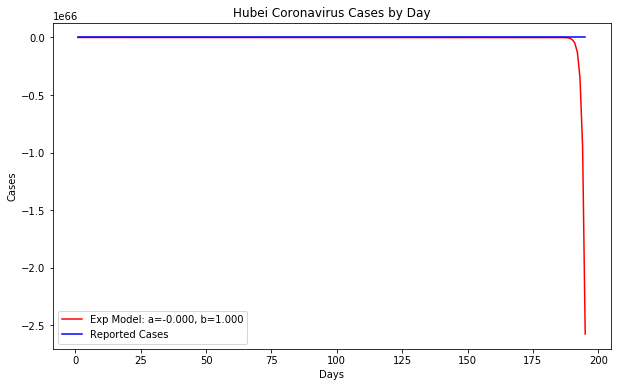

In [44]:
#conf range https://lmfit.github.io/lmfit-py/model.html

Cases=final_df_MChina_Hubei['Cases']
Days=final_df_MChina_Hubei['Day']

#empirical data
xdata = Days
y = Cases
ydata = y




popt, pcov = curve_fit(func, xdata, ydata)


fig, ax = plt.subplots(1, 1, figsize=(10, 6))
ax.plot(xdata, func(xdata, *popt), 'r-',label='Exp Model: a=%5.3f, b=%5.3f' % tuple(popt))
ax.plot(xdata, ydata, 'b-', label='Reported Cases')
plt.xlabel('Days')
plt.ylabel('Cases')
ax.set_title('Hubei Coronavirus Cases by Day')
ax.legend()

In [45]:
final_df_MChina_Hubei.head()

,Province/State,name,Country/Region,Lat,Long,Cases,Date,Date_proper,Day,Delta_Cases,Delta_Cases7,Acceleration,Acceleration7
12090,Hubei,Hubei China,China,30.9756,112.271,444,1/22/20,2020-01-22,1.0,NaN,NaN,NaN,NaN
12091,Hubei,Hubei China,China,30.9756,112.271,444,1/23/20,2020-01-23,2.0,0.0,NaN,NaN,NaN
12092,Hubei,Hubei China,China,30.9756,112.271,549,1/24/20,2020-01-24,3.0,105.0,NaN,105.0,NaN
12093,Hubei,Hubei China,China,30.9756,112.271,761,1/25/20,2020-01-25,4.0,212.0,NaN,107.0,NaN
12094,Hubei,Hubei China,China,30.9756,112.271,1058,1/26/20,2020-01-26,5.0,297.0,NaN,85.0,NaN


## Forecasting Future Cases

In [46]:
 

final_df_MChina_Hubei['y']=final_df_MChina_Hubei['Cases']
final_df_MChina_Hubei['ds']=final_df_MChina_Hubei['Date']


#Guangdong
final_df_MChina_Guangdong['y']=final_df_MChina_Guangdong['Cases']
final_df_MChina_Guangdong['ds']=final_df_MChina_Guangdong['Date']

#Zhejiang
final_df_MChina_Zhejiang['y']=final_df_MChina_Zhejiang['Cases']
final_df_MChina_Zhejiang['ds']=final_df_MChina_Zhejiang['Date']

#Henan
final_df_MChina_Henan['y']=final_df_MChina_Henan['Cases']
final_df_MChina_Henan['ds']=final_df_MChina_Henan['Date']

#Hunan
final_df_MChina_Hunan['y']=final_df_MChina_Hunan['Cases']
final_df_MChina_Hunan['ds']=final_df_MChina_Hunan['Date']

#Anhui
final_df_MChina_Anhui['y']=final_df_MChina_Anhui['Cases']
final_df_MChina_Anhui['ds']=final_df_MChina_Anhui['Date']

#Jiangxi
final_df_MChina_Jiangxi['y']=final_df_MChina_Jiangxi['Cases']
final_df_MChina_Jiangxi['ds']=final_df_MChina_Jiangxi['Date']




C:\Users\neil.watt\AppData\Local\Continuum\anaconda3\lib\site-packages\ipykernel_launcher.py:3: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\neil.watt\AppData\Local\Continuum\anaconda3\lib\site-packages\ipykernel_launcher.py:4: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\neil.watt\AppData\Local\Continuum\anaconda3\lib\site-packages\ipykernel_launcher.py:8: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats 

In [47]:

from fbprophet import Prophet
from fbprophet.plot import add_changepoints_to_plot


#NOTE, DEFAULT changepoint_prior_scale IS 0.05, DECREASING makes less flexible, INCREASIGN makes more flexible
changepoint_prior_scale_new=0.05
periods_new=30


df_Hubei=final_df_MChina_Hubei
gm_prophet = Prophet(interval_width=0.95, changepoint_prior_scale=changepoint_prior_scale_new)
gm_prophet.fit(df_Hubei)
future = gm_prophet.make_future_dataframe(periods=periods_new)



#Guangdong

df_Guangdong=final_df_MChina_Guangdong
gm_prophet_Guangdong = Prophet(interval_width=0.95, changepoint_prior_scale=changepoint_prior_scale_new)
gm_prophet_Guangdong.fit(df_Guangdong)
future_Guangdong = gm_prophet_Guangdong.make_future_dataframe(periods=periods_new)


#Zhejiang
df_Zhejiang=final_df_MChina_Zhejiang
gm_prophet_Zhejiang = Prophet(interval_width=0.95, changepoint_prior_scale=changepoint_prior_scale_new)
gm_prophet_Zhejiang.fit(df_Zhejiang)
future_Zhejiang = gm_prophet_Zhejiang.make_future_dataframe(periods=periods_new)


#Henan
df_Henan=final_df_MChina_Henan
gm_prophet_Henan = Prophet(interval_width=0.95, changepoint_prior_scale=changepoint_prior_scale_new)
gm_prophet_Henan.fit(df_Henan)
future_Henan = gm_prophet_Henan.make_future_dataframe(periods=periods_new)



#Hunan
df_Hunan=final_df_MChina_Hunan
gm_prophet_Hunan = Prophet(interval_width=0.95, changepoint_prior_scale=changepoint_prior_scale_new)
gm_prophet_Hunan.fit(df_Hunan)
future_Hunan = gm_prophet_Hunan.make_future_dataframe(periods=periods_new)


#Anhui
df_Anhui=final_df_MChina_Anhui
gm_prophet_Anhui = Prophet(interval_width=0.95, changepoint_prior_scale=changepoint_prior_scale_new)
gm_prophet_Anhui.fit(df_Anhui)
future_Anhui = gm_prophet_Anhui.make_future_dataframe(periods=periods_new)


#Jiangxi
df_Jiangxi=final_df_MChina_Jiangxi
gm_prophet_Jiangxi = Prophet(interval_width=0.95, changepoint_prior_scale=changepoint_prior_scale_new)
gm_prophet_Jiangxi.fit(df_Jiangxi)
future_Jiangxi = gm_prophet_Jiangxi.make_future_dataframe(periods=periods_new)





INFO:fbprophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\neil.watt\AppData\Local\Continuum\anaconda3\lib\site-packages\pystan\misc.py:399: FutureWarning:

Conversion of the second argument of issubdtype from `float` to `np.floating` is deprecated. In future, it will be treated as `np.float64 == np.dtype(float).type`.

INFO:fbprophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:fbprophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:fbprophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:f

In [48]:
#create forecast with upper and lower bounds
forecast = gm_prophet.predict(future)
#forecast[['ds', 'yhat', 'yhat_lower', 'yhat_upper']].tail()

#Guangdong
forecast_Guangdong = gm_prophet_Guangdong.predict(future_Guangdong)


#Zhejiang
forecast_Zhejiang = gm_prophet_Zhejiang.predict(future_Zhejiang)

#Henan

forecast_Henan = gm_prophet_Henan.predict(future_Henan)

#Hunan
forecast_Hunan = gm_prophet_Hunan.predict(future_Hunan)


#Anhui
forecast_Anhui = gm_prophet_Anhui.predict(future_Anhui)

#Jiangxi
forecast_Jiangxi = gm_prophet_Jiangxi.predict(future_Jiangxi)




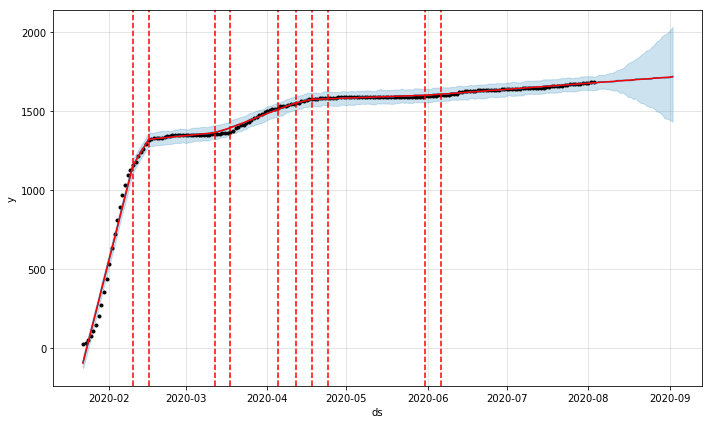

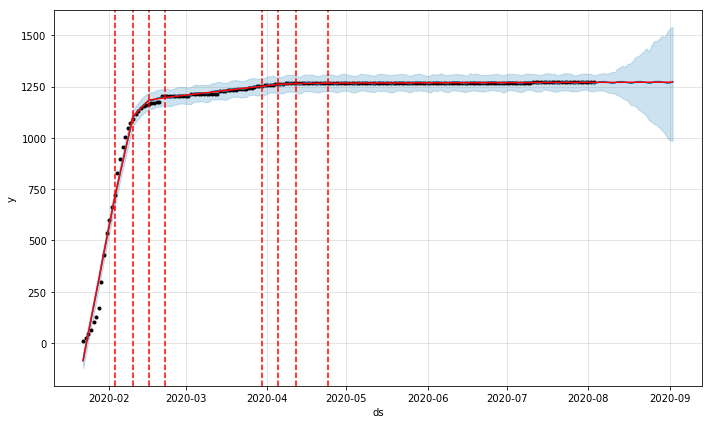

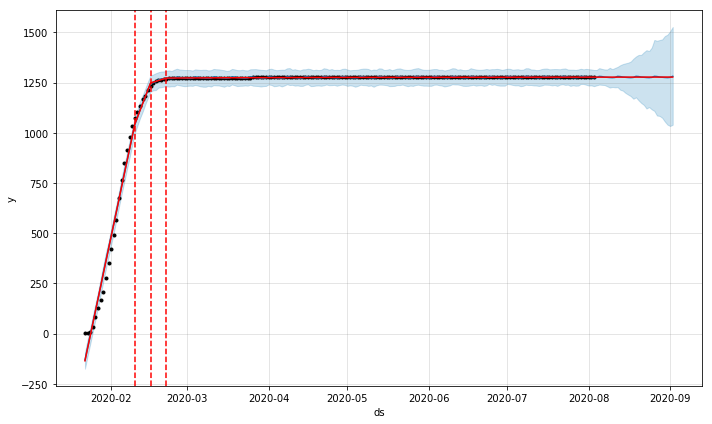

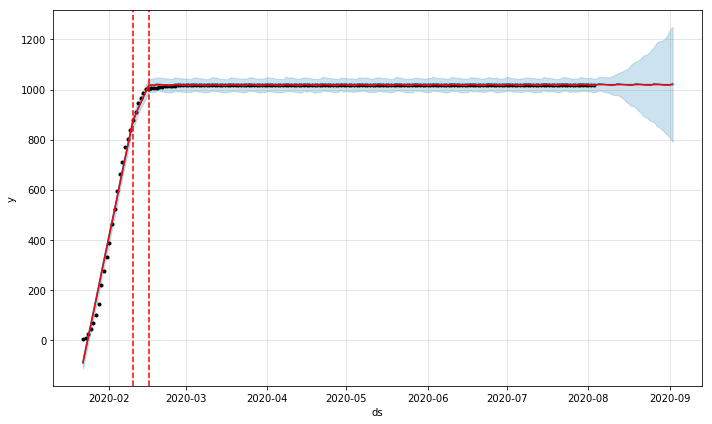

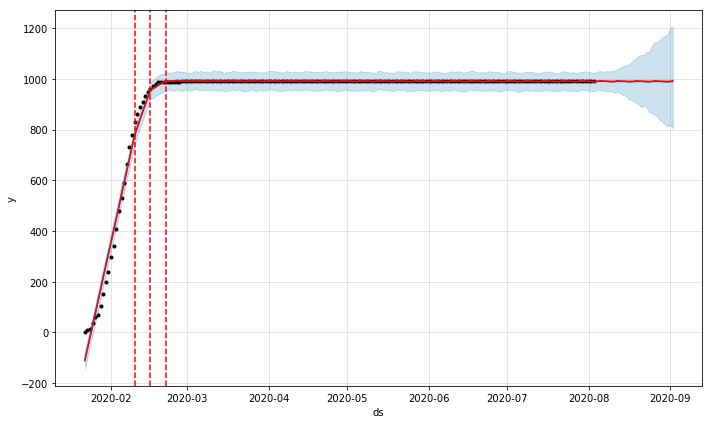

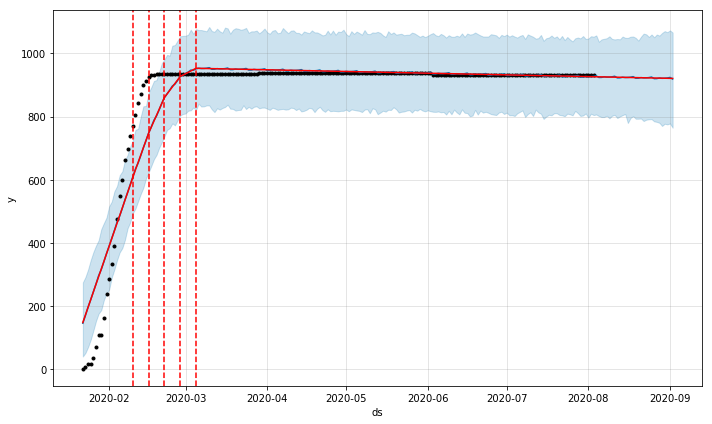

In [49]:






fig_Guangdong = gm_prophet_Guangdong.plot(forecast_Guangdong)
changepoints_Guangdong = add_changepoints_to_plot(fig_Guangdong.gca(), gm_prophet_Guangdong, forecast_Guangdong)


fig_Zhejiang = gm_prophet_Zhejiang.plot(forecast_Zhejiang)
changepoints_Zhejiang = add_changepoints_to_plot(fig_Zhejiang.gca(), gm_prophet_Zhejiang, forecast_Zhejiang)

fig_Henan = gm_prophet_Henan.plot(forecast_Henan)
changepoints_Henan = add_changepoints_to_plot(fig_Henan.gca(), gm_prophet_Henan, forecast_Henan)


fig_Hunan = gm_prophet_Hunan.plot(forecast_Hunan)
changepoints_Hunan = add_changepoints_to_plot(fig_Hunan.gca(), gm_prophet_Hunan, forecast_Hunan)


fig_Anhui = gm_prophet_Anhui.plot(forecast_Anhui)
changepoints_Anhui = add_changepoints_to_plot(fig_Anhui.gca(), gm_prophet_Anhui, forecast_Anhui)


fig_Jiangxi = gm_prophet_Jiangxi.plot(forecast_Jiangxi)
changepoints_Jiangxi = add_changepoints_to_plot(fig_Jiangxi.gca(), gm_prophet_Jiangxi, forecast_Jiangxi)

#### Comparing trajectory of new cases for various provinces (Mainland China)

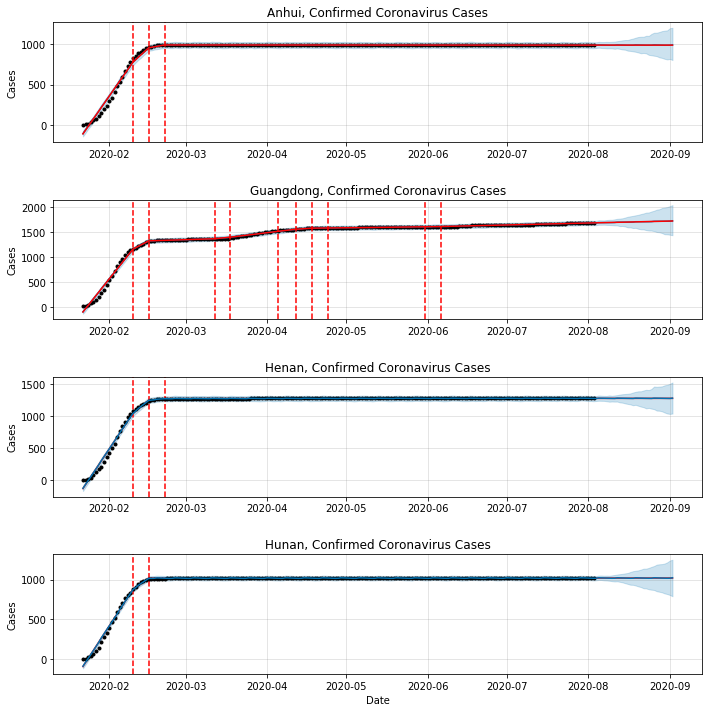

In [50]:

# plot major provinces showing similar change in trend (after redfinition of "infected")
#https://www.taiwannews.com.tw/en/news/3874490

fig = plt.figure(figsize=(10, 10))


ax1 = fig.add_subplot(4, 1, 1)
gm_prophet_Anhui.plot(forecast_Anhui, ax=ax1)
ax1.set_title('Anhui, Confirmed Coronavirus Cases')
changepoints = add_changepoints_to_plot(fig.gca(), gm_prophet_Anhui, forecast_Anhui)



ax2 = fig.add_subplot(4, 1, 2)
gm_prophet_Guangdong.plot(forecast_Guangdong, ax=ax2)
changepoints_Guangdong = add_changepoints_to_plot(fig.gca(), gm_prophet_Guangdong, forecast_Guangdong)
ax2.set_title('Guangdong, Confirmed Coronavirus Cases')

ax3 = fig.add_subplot(4, 1, 3)
changepoints_Henan = add_changepoints_to_plot(fig.gca(), gm_prophet_Henan, forecast_Henan)
gm_prophet_Henan.plot(forecast_Henan, ax=ax3)
ax3.set_title('Henan, Confirmed Coronavirus Cases')



ax4 = fig.add_subplot(4, 1, 4)
changepoints_Hunan = add_changepoints_to_plot(fig.gca(), gm_prophet_Hunan, forecast_Hunan)
gm_prophet_Hunan.plot(forecast_Hunan, ax=ax4)
ax4.set_title('Hunan, Confirmed Coronavirus Cases')




axes = fig.get_axes()
axes[0].set_xlabel('')
axes[0].set_ylabel('Cases')
axes[1].set_xlabel('')
axes[1].set_ylabel('Cases')
axes[2].set_xlabel('')
axes[2].set_ylabel('Cases')
axes[3].set_xlabel('Date')
axes[3].set_ylabel('Cases')

fig.savefig('temp.png', dpi=100)


Text(47.625,0.5,'Cases')

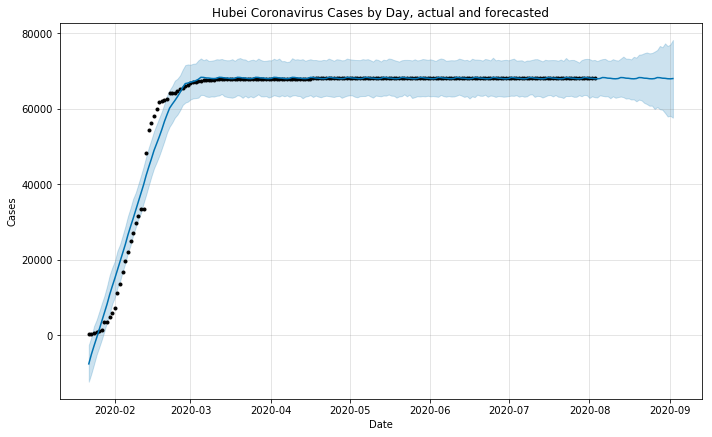

In [51]:
fig1 = gm_prophet.plot(forecast)
plt.title('Hubei Coronavirus Cases by Day, actual and forecasted');
axes = fig1.get_axes()
axes[0].set_xlabel('Date')
axes[0].set_ylabel('Cases')


Text(47.625,0.5,'Cases')

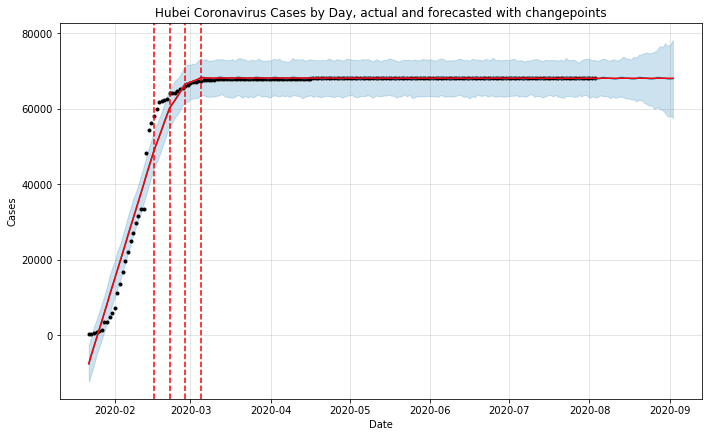

In [52]:
#added change points to forecast
from fbprophet.plot import add_changepoints_to_plot
fig2= gm_prophet.plot(forecast)
a = add_changepoints_to_plot(fig2.gca(), gm_prophet, forecast)
plt.title('Hubei Coronavirus Cases by Day, actual and forecasted with changepoints');
axes = fig2.get_axes()
axes[0].set_xlabel('Date')
axes[0].set_ylabel('Cases')





### Forecast International Cases (ex Mainland China)

In [53]:
final_df_international['Date'][30:,]

30       2/21/20
31       2/22/20
32       2/23/20
33       2/24/20
34       2/25/20
35       2/26/20
36       2/27/20
37       2/28/20
38       2/29/20
39        3/1/20
40        3/2/20
41        3/3/20
42        3/4/20
43        3/5/20
44        3/6/20
45        3/7/20
46        3/8/20
47        3/9/20
48       3/10/20
49       3/11/20
50       3/12/20
51       3/13/20
52       3/14/20
53       3/15/20
54       3/16/20
55       3/17/20
56       3/18/20
57       3/19/20
58       3/20/20
59       3/21/20
          ...   
51840     7/5/20
51841     7/6/20
51842     7/7/20
51843     7/8/20
51844     7/9/20
51845    7/10/20
51846    7/11/20
51847    7/12/20
51848    7/13/20
51849    7/14/20
51850    7/15/20
51851    7/16/20
51852    7/17/20
51853    7/18/20
51854    7/19/20
51855    7/20/20
51856    7/21/20
51857    7/22/20
51858    7/23/20
51859    7/24/20
51860    7/25/20
51861    7/26/20
51862    7/27/20
51863    7/28/20
51864    7/29/20
51865    7/30/20
51866    7/31/20
51867     8/1/

In [54]:
final_df_international_adjust = final_df_international[(final_df_international['Date'] > '2/23/20') ]
final_df_international_adjust

,Province/State,name,Country/Region,Lat,Long,Cases,Date,Date_proper,Day,Delta_Cases,Delta_Cases7,Acceleration,Acceleration7,total_cases
12,,Afghanistan,Afghanistan,33.9391,67.71,0,2/3/20,2020-02-03,13.0,0.0,0.000000,0.0,0.000000,171
13,,Afghanistan,Afghanistan,33.9391,67.71,0,2/4/20,2020-02-04,14.0,0.0,0.000000,0.0,0.000000,191
14,,Afghanistan,Afghanistan,33.9391,67.71,0,2/5/20,2020-02-05,15.0,0.0,0.000000,0.0,0.000000,203
15,,Afghanistan,Afghanistan,33.9391,67.71,0,2/6/20,2020-02-06,16.0,0.0,0.000000,0.0,0.000000,215
16,,Afghanistan,Afghanistan,33.9391,67.71,0,2/7/20,2020-02-07,17.0,0.0,0.000000,0.0,0.000000,285
17,,Afghanistan,Afghanistan,33.9391,67.71,0,2/8/20,2020-02-08,18.0,0.0,0.000000,0.0,0.000000,315
18,,Afghanistan,Afghanistan,33.9391,67.71,0,2/9/20,2020-02-09,19.0,0.0,0.000000,0.0,0.000000,330
33,,Afghanistan,Afghanistan,33.9391,67.71,1,2/24/20,2020-02-24,34.0,1.0,0.142857,1.0,0.142857,2304
34,,Afghanistan,Afghanistan,33.9391,67.71,1,2/25/20,2020-02-25,35.0,0.0,0.142857,-1.0,0.000000,2644
35,,Afghanistan,Afghanistan,33.9391,67.71,1,2/26/20,2020-02-26,36.0,0.0,0.142857,0.0,0.000000,3209


In [55]:

final_df_international_adjust = final_df_international[(final_df_international['Date'] > '2020-02-20') ]
final_df_international_adjust['y']=final_df_international_adjust['total_cases']
final_df_international_adjust['ds']=final_df_international_adjust['Date']


C:\Users\neil.watt\AppData\Local\Continuum\anaconda3\lib\site-packages\ipykernel_launcher.py:3: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\neil.watt\AppData\Local\Continuum\anaconda3\lib\site-packages\ipykernel_launcher.py:4: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy



In [56]:
from fbprophet import Prophet
from fbprophet.plot import add_changepoints_to_plot

#NOTE, DEFAULT changepoint_prior_scale IS 0.05, DECREASING makes less flexible, INCREASIGN makes more flexible

changepoint_prior_scale_new_int=0.05
periods_new_int=30


In [57]:
#df_Hubei=final_df_MChina_Hubei
gm_prophet_int = Prophet(interval_width=0.95, changepoint_prior_scale=changepoint_prior_scale_new_int)
gm_prophet_int.fit(final_df_international_adjust)
future_int = gm_prophet_int.make_future_dataframe(periods=periods_new_int)

forecast_int = gm_prophet_int.predict(future_int)


INFO:fbprophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\neil.watt\AppData\Local\Continuum\anaconda3\lib\site-packages\pystan\misc.py:399: FutureWarning:

Conversion of the second argument of issubdtype from `float` to `np.floating` is deprecated. In future, it will be treated as `np.float64 == np.dtype(float).type`.



Text(63,0.5,'Cases')

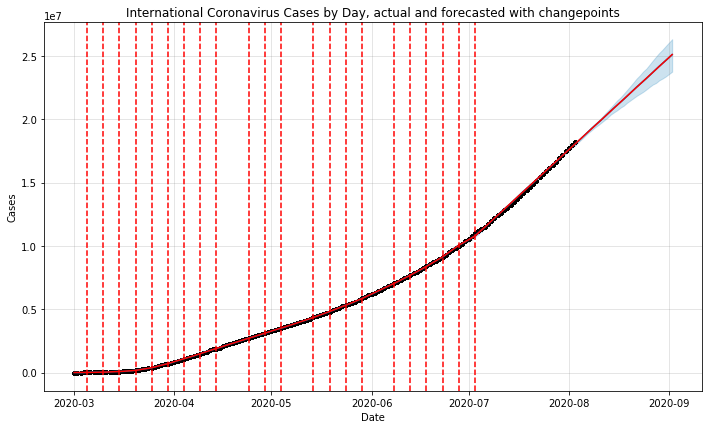

In [58]:
#added change points to forecast
from fbprophet.plot import add_changepoints_to_plot
fig2= gm_prophet_int.plot(forecast_int)
a = add_changepoints_to_plot(fig2.gca(), gm_prophet_int, forecast_int)
plt.title('International Coronavirus Cases by Day, actual and forecasted with changepoints');
axes = fig2.get_axes()
axes[0].set_xlabel('Date')
axes[0].set_ylabel('Cases')


### Predictions of Euro Countries (changepoints)

In [59]:
final_df_Euro

,Province/State,name,Country/Region,Lat,Long,Cases,Date,Date_proper,Day,Delta_Cases,Delta_Cases7,Acceleration,Acceleration7,total_cases
195,,Albania,Albania,41.1533,20.1683,0,1/22/20,2020-01-22,1.0,NaN,NaN,NaN,NaN,0
196,,Albania,Albania,41.1533,20.1683,0,1/23/20,2020-01-23,2.0,0.0,NaN,NaN,NaN,0
197,,Albania,Albania,41.1533,20.1683,0,1/24/20,2020-01-24,3.0,0.0,NaN,0.0,NaN,2
198,,Albania,Albania,41.1533,20.1683,0,1/25/20,2020-01-25,4.0,0.0,NaN,0.0,NaN,3
199,,Albania,Albania,41.1533,20.1683,0,1/26/20,2020-01-26,5.0,0.0,NaN,0.0,NaN,3
200,,Albania,Albania,41.1533,20.1683,0,1/27/20,2020-01-27,6.0,0.0,NaN,0.0,NaN,4
201,,Albania,Albania,41.1533,20.1683,0,1/28/20,2020-01-28,7.0,0.0,NaN,0.0,NaN,8
202,,Albania,Albania,41.1533,20.1683,0,1/29/20,2020-01-29,8.0,0.0,0.000000,0.0,NaN,10
203,,Albania,Albania,41.1533,20.1683,0,1/30/20,2020-01-30,9.0,0.0,0.000000,0.0,0.000000,10
204,,Albania,Albania,41.1533,20.1683,0,1/31/20,2020-01-31,10.0,0.0,0.000000,0.0,0.000000,16


In [60]:
df_France = final_df_Euro[final_df_Euro['name']== 'France France']
df_France

,Province/State,name,Country/Region,Lat,Long,Cases,Date,Date_proper,Day,Delta_Cases,Delta_Cases7,Acceleration,Acceleration7,total_cases


In [61]:


#define country DFs


Euro_list=[' Austria', ' Belgium', ' Bosnia and Herzegovina', ' Cyprus', ' Czech Republic', ' Denmark', ' Finland', ' France', ' Germany', ' Gibraltar', ' Hungary', ' Iceland', ' Ireland', ' Italy', ' Malta', ' Netherlands', ' Norway', ' Poland', ' Portugal', ' Spain', ' Sweden', ' Switzerland', ' United Kingdom', ' Albania', ' Bulgaria', ' Channel Islands', ' Faroe Islands', ' Greece', ' Liechtenstein', ' North Macedonia', ' Romania'

]

final_df_Euro=final_df_international[final_df_international['name'].isin(Euro_list)]


# France
df_France = final_df_Euro[final_df_Euro['name']== ' France']
df_France['y']= df_France['Cases']
df_France['ds']= df_France['Date']

#UK
df_UK= final_df_Euro[final_df_Euro['name']== ' United Kingdom']
df_UK['y']= df_UK['Cases']
df_UK['ds']= df_UK['Date']

# Italy 
df_Italy = final_df_Euro [final_df_Euro['name']== ' Italy']
df_Italy['y']= df_Italy['Cases']
df_Italy['ds']= df_Italy['Date']

#Spain
df_Spain = final_df_Euro [final_df_Euro['name']== ' Spain']
df_Spain['y']= df_Spain['Cases']
df_Spain['ds']= df_Spain['Date']

#Germany
df_Germany = final_df_Euro [final_df_Euro['name']== ' Germany']
df_Germany['y']= df_Germany['Cases']
df_Germany['ds']= df_Germany['Date']




C:\Users\neil.watt\AppData\Local\Continuum\anaconda3\lib\site-packages\ipykernel_launcher.py:15: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\neil.watt\AppData\Local\Continuum\anaconda3\lib\site-packages\ipykernel_launcher.py:16: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\neil.watt\AppData\Local\Continuum\anaconda3\lib\site-packages\ipykernel_launcher.py:20: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cavea

In [62]:
#make predictions
from fbprophet import Prophet
from fbprophet.plot import add_changepoints_to_plot


#NOTE, DEFAULT changepoint_prior_scale IS 0.05, DECREASING makes less flexible, INCREASIGN makes more flexible
changepoint_prior_scale_new2=0.2
periods_new=30


#France
gm_prophet_France = Prophet(interval_width=0.95, changepoint_prior_scale=changepoint_prior_scale_new2)
gm_prophet_France.fit(df_France)
future_France = gm_prophet_France.make_future_dataframe(periods=periods_new)

#UK
gm_prophet_UK = Prophet(interval_width=0.95, changepoint_prior_scale=changepoint_prior_scale_new2)
gm_prophet_UK.fit(df_UK)
future_UK = gm_prophet_UK.make_future_dataframe(periods=periods_new)


# Italy 

gm_prophet_Italy = Prophet(interval_width=0.95, changepoint_prior_scale=changepoint_prior_scale_new2)
gm_prophet_Italy.fit(df_Italy)
future_Italy = gm_prophet_Italy.make_future_dataframe(periods=periods_new)

#Spain

gm_prophet_Spain = Prophet(interval_width=0.95, changepoint_prior_scale=changepoint_prior_scale_new2)
gm_prophet_Spain.fit(df_Spain)
future_Spain = gm_prophet_Spain.make_future_dataframe(periods=periods_new)


#Germany

gm_prophet_Germany = Prophet(interval_width=0.95, changepoint_prior_scale=changepoint_prior_scale_new2)
gm_prophet_Germany.fit(df_Germany)
future_Germany = gm_prophet_Germany.make_future_dataframe(periods=periods_new)


INFO:fbprophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\neil.watt\AppData\Local\Continuum\anaconda3\lib\site-packages\pystan\misc.py:399: FutureWarning:

Conversion of the second argument of issubdtype from `float` to `np.floating` is deprecated. In future, it will be treated as `np.float64 == np.dtype(float).type`.

INFO:fbprophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:fbprophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:fbprophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:f

In [63]:
#create forecast with upper and lower bounds
forecast = gm_prophet.predict(future)
#forecast[['ds', 'yhat', 'yhat_lower', 'yhat_upper']].tail()

#France
forecast_France = gm_prophet_France.predict(future_France)

#UK
forecast_UK = gm_prophet_UK.predict(future_UK)

#Italy
forecast_Italy = gm_prophet_Italy.predict(future_Italy)

#Spain
forecast_Spain = gm_prophet_Spain.predict(future_Spain)

# Germany 
forecast_Germany = gm_prophet_Germany.predict(future_Germany)


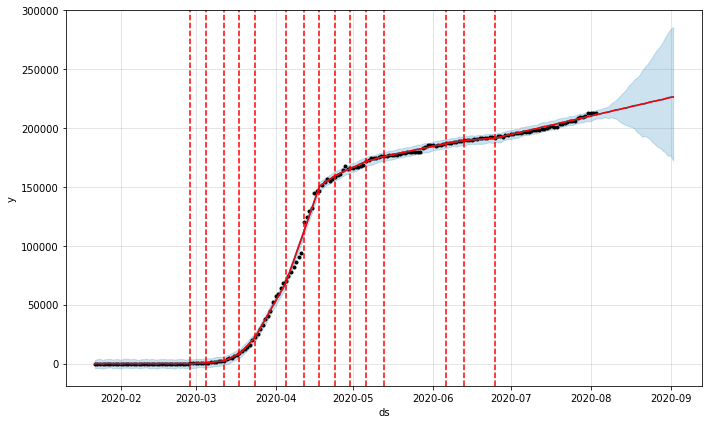

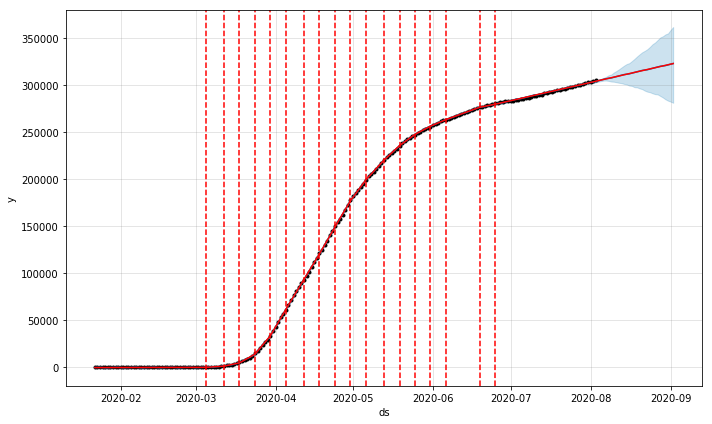

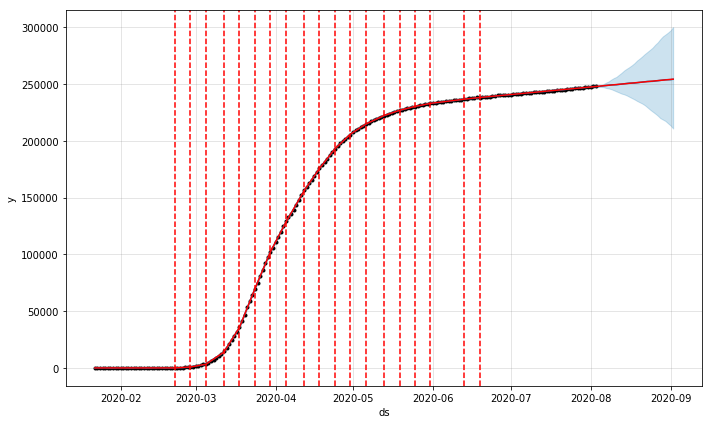

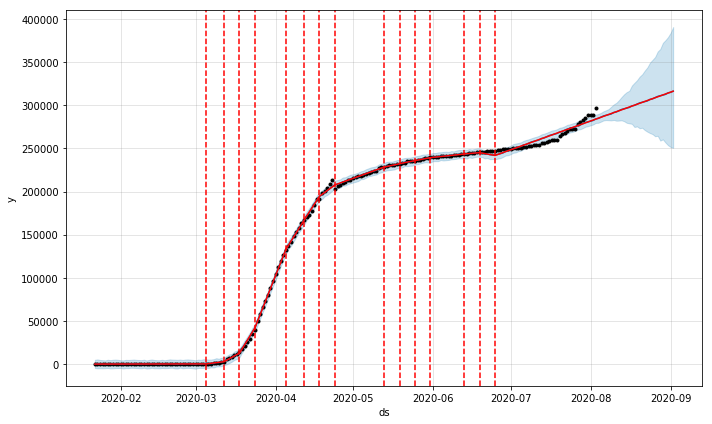

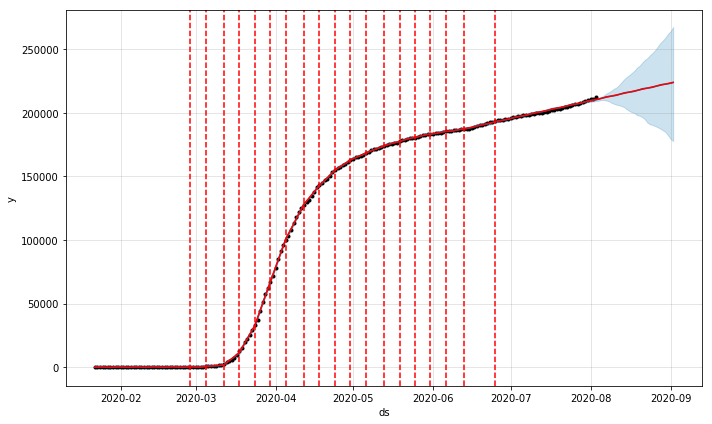

In [64]:
#create figures

#France
fig_France = gm_prophet_France.plot(forecast_France)
changepoints_France = add_changepoints_to_plot(fig_France.gca(), gm_prophet_France, forecast_France)

#UK
fig_UK = gm_prophet_UK.plot(forecast_UK)
changepoints_UK = add_changepoints_to_plot(fig_UK.gca(), gm_prophet_UK, forecast_UK)


#Italy
fig_Italy = gm_prophet_Italy.plot(forecast_Italy)
changepoints_Italy = add_changepoints_to_plot(fig_Italy.gca(), gm_prophet_Italy, forecast_Italy)


#Spain
fig_Spain = gm_prophet_Spain.plot(forecast_Spain)
changepoints_Spain = add_changepoints_to_plot(fig_Spain.gca(), gm_prophet_Spain, forecast_Spain)

# Germany 
fig_Germany = gm_prophet_Germany.plot(forecast_Germany)
changepoints_Germany = add_changepoints_to_plot(fig_Germany.gca(), gm_prophet_Germany, forecast_Germany)


Text(41.25,0.5,'Cases')

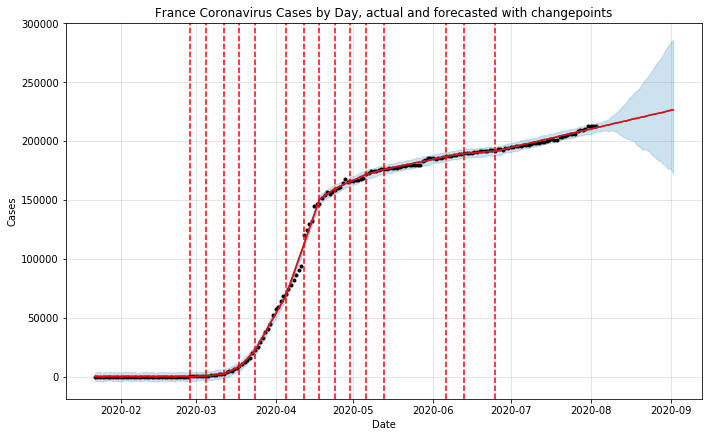

In [65]:
from fbprophet.plot import add_changepoints_to_plot
fig2= gm_prophet_France.plot(forecast_France)
a = add_changepoints_to_plot(fig2.gca(), gm_prophet_France, forecast_France)
plt.title('France Coronavirus Cases by Day, actual and forecasted with changepoints');
axes = fig2.get_axes()
axes[0].set_xlabel('Date')
axes[0].set_ylabel('Cases')

Text(41.25,0.5,'Cases')

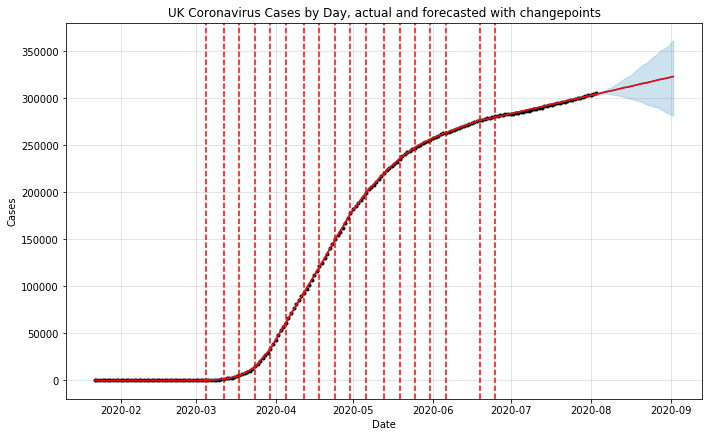

In [66]:

from fbprophet.plot import add_changepoints_to_plot
fig2= gm_prophet_UK.plot(forecast_UK)
a = add_changepoints_to_plot(fig2.gca(), gm_prophet_UK, forecast_UK)
plt.title('UK Coronavirus Cases by Day, actual and forecasted with changepoints');
axes = fig2.get_axes()
axes[0].set_xlabel('Date')
axes[0].set_ylabel('Cases')

Text(41.25,0.5,'Cases')

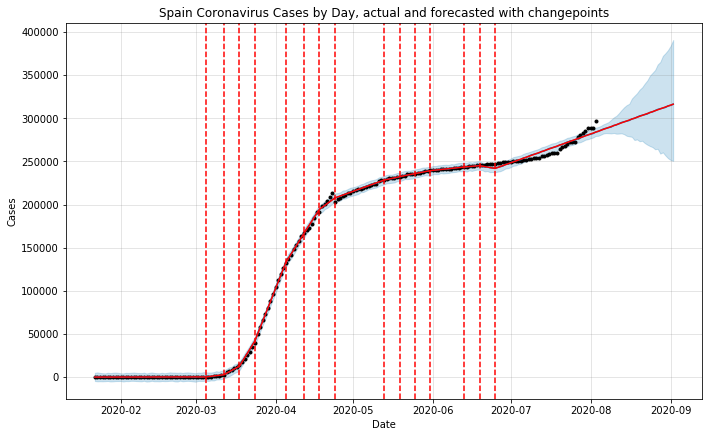

In [67]:

from fbprophet.plot import add_changepoints_to_plot
fig2= gm_prophet_Spain.plot(forecast_Spain)
a = add_changepoints_to_plot(fig2.gca(), gm_prophet_Spain, forecast_Spain)
plt.title('Spain Coronavirus Cases by Day, actual and forecasted with changepoints');
axes = fig2.get_axes()
axes[0].set_xlabel('Date')
axes[0].set_ylabel('Cases')

Text(41.25,0.5,'Cases')

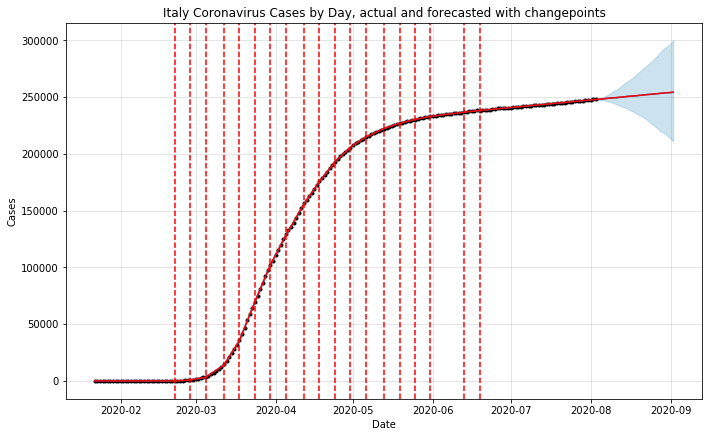

In [68]:

from fbprophet.plot import add_changepoints_to_plot
fig2= gm_prophet_Italy.plot(forecast_Italy)
a = add_changepoints_to_plot(fig2.gca(), gm_prophet_Italy, forecast_Italy)
plt.title('Italy Coronavirus Cases by Day, actual and forecasted with changepoints');
axes = fig2.get_axes()
axes[0].set_xlabel('Date')
axes[0].set_ylabel('Cases')

Text(41.25,0.5,'Cases')

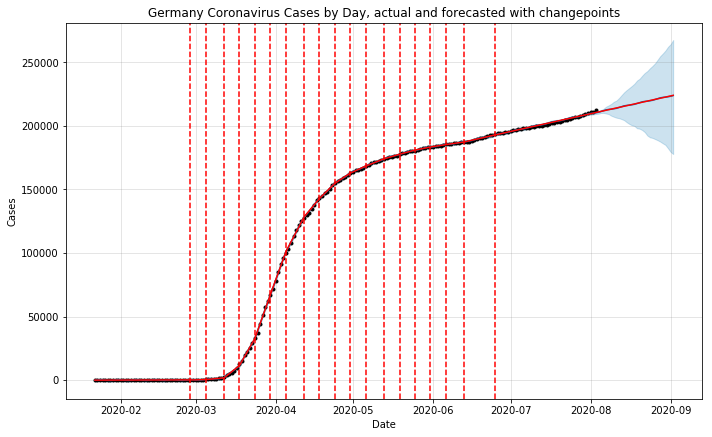

In [69]:


from fbprophet.plot import add_changepoints_to_plot
fig2= gm_prophet_Germany.plot(forecast_Germany)
a = add_changepoints_to_plot(fig2.gca(), gm_prophet_Germany, forecast_Germany)
plt.title('Germany Coronavirus Cases by Day, actual and forecasted with changepoints');
axes = fig2.get_axes()
axes[0].set_xlabel('Date')
axes[0].set_ylabel('Cases')



In [70]:
import plotly.express as px


fig = px.line(final_df_international,title="International Cases outside Mainland China", x="Date", y="total_cases", color="name", line_group="name", render_mode="svg")
fig.for_each_trace(lambda t: t.update(name=t.name.replace("name=", "")))
fig.show()

## Flights Analysis

In [71]:
#https://pcfg.eu/posts/how-to-plot-flight-routes-using-plotly/

# Import libraries
import pandas as pd
#import plotly.plotly as py
import plotly.offline as ol
from geographiclib.geodesic import Geodesic
geod = Geodesic.WGS84

# Define function to calculate distance (in meters) between two points
def dist(p1Lat, p1Lon, p2Lat, p2Lon):
    return geod.Inverse(p1Lat, p1Lon, p2Lat, p2Lon, Geodesic.DISTANCE)['s12']

# Read the data into a dataframe (specifying the column names)

#read_conf = pd.read_csv('/Users/neil.watt/Documents/PythonScripts/Coronavirus/coronavirus_stats_conf2.csv', encoding = "ISO-8859-1")


#df = pd.read_csv('routes.dat', sep=',', header=None,
 #                names=['Airline','Airline ID','Source airport','Source airport ID',
  #                      'Destination airport','Destination airport ID','Codeshare',
   #                     'Stops','Equipment'])



df = pd.read_csv('/Users/neil.watt/Documents/PythonScripts/Coronavirus/routes.dat.txt',sep=',', header=None,
                 names=['Airline','Airline ID','Source airport','Source airport ID',
                        'Destination airport','Destination airport ID','Codeshare',
                        'Stops','Equipment'])



In [72]:
# Remove duplicates (only one trajectory per route)
df = df[['Source airport','Destination airport']].drop_duplicates(keep='first', inplace=False)

# Read the data into a dataframe (specifying the column names)
df_airports = pd.read_csv('/Users/neil.watt/Documents/PythonScripts/Coronavirus/airports.dat.txt', sep=',', header=None,
                          names=['Airport','Name','City','Country','IATA','ICAO',
                                 'Latitude','Longitude','Altitude','Timezone','DST',
                                 'Tz','Type','Source'])

In [73]:
## ALL LONDON AIRPORTS

# Select only those routes starting or ending from a London Airport
# in order London City, Heathrow, Gatwick, Luton, Stansted, Southend
df = df.loc[(df['Source airport'].isin(['LCY','LHR','LGW','LTN','STN','SEN'])) | (df['Destination airport'].isin(['LCY','LHR','LGW','LTN','STN','SEN']))]

# Append the origin airport's coordinates to the routes' dataframe
df = pd.merge(df, df_airports[['IATA','Latitude','Longitude']],
              how='inner', left_on='Source airport', right_on='IATA', suffixes=('_Orig','_Dest'))

# Append the destination airport's coordinates to the routes' dataframe
df = pd.merge(df, df_airports[['IATA','Latitude','Longitude']],
              how='inner', left_on='Destination airport', right_on='IATA', suffixes=('_Orig','_Dest'))

# Keep only Origin/Destination IATA ID columns, and their Latitude/Longitude
df = df.drop(columns=['Source airport','Destination airport'])

# Calculate the distance (great circle distance) between the origin and destination airports
df['Distance'] = ''
for index, row in df.iterrows():
    df.loc[df.index==index,'Distance'] = dist(row.Latitude_Orig, row.Longitude_Orig, row.Latitude_Dest, row.Longitude_Dest)/1000

# Initialise the data list that will be used to feed the plot
data = []

# Append all airports (blue dots) to the map
data.append(dict(
                type = 'scattergeo',
                locationmode = 'ISO-3',
                showlegend = False,
                lon = df_airports['Longitude'],
                lat = df_airports['Latitude'],
                hoverinfo = 'text',
                text = df_airports['IATA'],
                mode = 'markers',
                marker = dict(
                    size=2,
                    color='rgb(0, 0, 255)',
                    line = dict(
                        width=3,
                        color='rgba(68, 68, 68, 0)'
                    )
                ))
        )

# Append the longest route to the map
data.append(
        dict(
            type = 'scattergeo',
            locationmode = 'ISO-3',
            name = 'Longest Route',
            showlegend = True,
            lon = [ df.loc[df['Distance']==df['Distance'].max(),'Longitude_Orig'].values[0], df.loc[df['Distance']==df['Distance'].max(),'Longitude_Dest'].values[0] ],
            lat = [ df.loc[df['Distance']==df['Distance'].max(),'Latitude_Orig'].values[0], df.loc[df['Distance']==df['Distance'].max(),'Latitude_Dest'].values[0] ],
            mode = 'lines',
            line = dict(
                width = 2,
                color = 'red',
            ),
            opacity = 1,
        )
    )

# Append all other routes to the map
for i in range(len(df)):
    data.append(
        dict(
            type = 'scattergeo',
            locationmode = 'ISO-3',
            name = str(df['IATA_Orig'][i]) + ' - ' + str(df['IATA_Dest'][i]),
            showlegend = True if df['IATA_Orig'][i] in ['LCY','LHR','LGW','LTN','STN','SEN'] else False,
            lon = [ df['Longitude_Orig'][i], df['Longitude_Dest'][i] ],
            lat = [ df['Latitude_Orig'][i], df['Latitude_Dest'][i] ],
            mode = 'lines',
            line = dict(
                width = 1,
                color = 'green',
            ),
            opacity = 0.3,
        )
    )

# Define the plot's layout
layout = dict(
        title = 'Airports and Routes',
        showlegend = True,
        geo = dict(
            scope='world',
            projection=dict( type='azimuthal equal area' ),
            showland = True,
            landcolor = 'rgb(255, 255, 255)',
            countrycolor = 'rgb(0, 0, 0)',
        ),
    )

# Create the figure to be plotted
fig = dict( data=data, layout=layout )
#py.plot(fig, world_readable=True)
ol.plot(fig, filename='Airports and routes.html')

'Airports and routes.html'

In [74]:
## Indian Airports


df_India=df_airports[df_airports['Country']=='India']
India_list=df_India['IATA'].tolist() 
India_list_new=list(set(India_list))


df_Iran=df_airports[df_airports['Country']=='Iran']
Iran_list=df_Iran['IATA'].tolist() 
Iran_list_new=list(set(Iran_list))

df_China=df_airports[df_airports['Country']=='China']
China_list=df_China['IATA'].tolist() 
China_list_new=list(set(China_list))

df_Italy=df_airports[df_airports['Country']=='Italy']
Italy_list=df_Italy['IATA'].tolist() 
Italy_list_new=list(set(Italy_list))

df_UK=df_airports[df_airports['Country']=='United Kingdom']
UK_list=df_UK['IATA'].tolist() 
UK_list_new=list(set(UK_list))

#final_df_MChina_Hubei=final_df_MChina[final_df_MChina['Province/State']=='Hubei']

#inal_df_MChina_Hubei=final_df_MChina[final_df_MChina['Province/State']=='Hubei']



In [75]:
UK_list_new

['EDI',
 'LPL',
 'LCY',
 'SOU',
 'GBA',
 'PLH',
 'NCL',
 'PIK',
 'NRL',
 'BHX',
 'HLE',
 'GLO',
 'LYX',
 'KNF',
 'NQT',
 'BWF',
 'FAB',
 'QUY',
 'ABZ',
 'QFO',
 'SYY',
 'FZO',
 'ESH',
 'YEO',
 'EMA',
 'LWK',
 'BRS',
 'OBN',
 'SOY',
 'EOI',
 'HAW',
 'BRR',
 'BEQ',
 'LTN',
 'CAX',
 'CWL',
 'LYE',
 'EXT',
 'ADX',
 'NHT',
 'FFD',
 'NDY',
 'BBS',
 'CEG',
 'FIE',
 'WRT',
 'OXF',
 'PSL',
 'LGW',
 'SCS',
 'LBA',
 'HYC',
 'NQY',
 'STN',
 'WRY',
 'BEB',
 'NWI',
 'QUG',
 'LDY',
 'WIC',
 'QLA',
 'CBG',
 'KRH',
 'QCY',
 'MAN',
 'HUY',
 'BLK',
 'LEQ',
 'BOH',
 'BBP',
 'PPW',
 'MSE',
 'CSA',
 'ENK',
 'VLY',
 'UNT',
 'LMO',
 'ILY',
 'SWS',
 'LHR',
 'OUK',
 'SQZ',
 'LKZ',
 'GLA',
 'INV',
 'MME',
 'ISC',
 'BQH',
 'CVT',
 'LSI',
 'KOI',
 'HRT',
 'FSS',
 'LYM',
 '\\N',
 'PZE',
 'BEX',
 'BZZ',
 'DSA',
 'WTN',
 'CAL',
 'ODH',
 'TRE',
 'BHD',
 'RCS',
 'SEN',
 'DND',
 'MHZ',
 'BFS']

In [76]:
['LCY','LHR','LGW','LTN','STN','SEN']

['LCY', 'LHR', 'LGW', 'LTN', 'STN', 'SEN']

In [77]:
# Import libraries
import pandas as pd
#import plotly.plotly as py
import plotly.offline as ol
from geographiclib.geodesic import Geodesic
geod = Geodesic.WGS84

# Define function to calculate distance (in meters) between two points
def dist(p1Lat, p1Lon, p2Lat, p2Lon):
    return geod.Inverse(p1Lat, p1Lon, p2Lat, p2Lon, Geodesic.DISTANCE)['s12']

# Read the data into a dataframe (specifying the column names)

#read_conf = pd.read_csv('/Users/neil.watt/Documents/PythonScripts/Coronavirus/coronavirus_stats_conf2.csv', encoding = "ISO-8859-1")


#df = pd.read_csv('routes.dat', sep=',', header=None,
 #                names=['Airline','Airline ID','Source airport','Source airport ID',
  #                      'Destination airport','Destination airport ID','Codeshare',
   #                     'Stops','Equipment'])



df = pd.read_csv('/Users/neil.watt/Documents/PythonScripts/Coronavirus/routes.dat.txt',sep=',', header=None,
                 names=['Airline','Airline ID','Source airport','Source airport ID',
                        'Destination airport','Destination airport ID','Codeshare',
                        'Stops','Equipment'])


In [78]:
# Remove duplicates (only one trajectory per route)
df = df[['Source airport','Destination airport']].drop_duplicates(keep='first', inplace=False)

# Read the data into a dataframe (specifying the column names)
df_airports = pd.read_csv('/Users/neil.watt/Documents/PythonScripts/Coronavirus/airports.dat.txt', sep=',', header=None,
                          names=['Airport','Name','City','Country','IATA','ICAO',
                                 'Latitude','Longitude','Altitude','Timezone','DST',
                                 'Tz','Type','Source'])

In [79]:
## ALL LONDON AIRPORTS

# Select only those routes starting or ending from a London Airport
# in order London City, Heathrow, Gatwick, Luton, Stansted, Southend

Country_List=UK_list_new

#India_list_new

# note pipemeans OR
#df = df.loc[(df['Source airport'].isin(Iran_list_new)) | (df['Destination airport'].isin(India_list_new))]
df = df.loc[(df['Source airport'].isin(Country_List)) | (df['Destination airport'].isin(Country_List))]

#df = df.loc[(df['Source airport'].isin(['LCY','LHR','LGW','LTN','STN','SEN'])) | (df['Destination airport'].isin(['LCY','LHR','LGW','LTN','STN','SEN']))]

# Append the origin airport's coordinates to the routes' dataframe
df = pd.merge(df, df_airports[['IATA','Latitude','Longitude']],
              how='inner', left_on='Source airport', right_on='IATA', suffixes=('_Orig','_Dest'))

# Append the destination airport's coordinates to the routes' dataframe
df = pd.merge(df, df_airports[['IATA','Latitude','Longitude']],
              how='inner', left_on='Destination airport', right_on='IATA', suffixes=('_Orig','_Dest'))

# Keep only Origin/Destination IATA ID columns, and their Latitude/Longitude
df = df.drop(columns=['Source airport','Destination airport'])

# Calculate the distance (great circle distance) between the origin and destination airports
df['Distance'] = ''
for index, row in df.iterrows():
    df.loc[df.index==index,'Distance'] = dist(row.Latitude_Orig, row.Longitude_Orig, row.Latitude_Dest, row.Longitude_Dest)/1000

# Initialise the data list that will be used to feed the plot
data = []

# Append all airports (blue dots) to the map
data.append(dict(
                type = 'scattergeo',
                locationmode = 'ISO-3',
                showlegend = False,
                lon = df_airports['Longitude'],
                lat = df_airports['Latitude'],
                hoverinfo = 'text',
                text = df_airports['IATA'],
                mode = 'markers',
                marker = dict(
                    size=2,
                    color='rgb(0, 0, 255)',
                    line = dict(
                        width=3,
                        color='rgba(68, 68, 68, 0)'
                    )
                ))
        )

# Append the longest route to the map
data.append(
        dict(
            type = 'scattergeo',
            locationmode = 'ISO-3',
            name = 'Longest Route',
            showlegend = True,
            lon = [ df.loc[df['Distance']==df['Distance'].max(),'Longitude_Orig'].values[0], df.loc[df['Distance']==df['Distance'].max(),'Longitude_Dest'].values[0] ],
            lat = [ df.loc[df['Distance']==df['Distance'].max(),'Latitude_Orig'].values[0], df.loc[df['Distance']==df['Distance'].max(),'Latitude_Dest'].values[0] ],
            mode = 'lines',
            line = dict(
                width = 2,
                color = 'red',
            ),
            opacity = 1,
        )
    )


#India_list_new

# Append all other routes to the map
for i in range(len(df)):
    data.append(
        dict(
            type = 'scattergeo',
            locationmode = 'ISO-3',
            name = str(df['IATA_Orig'][i]) + ' - ' + str(df['IATA_Dest'][i]),
            #showlegend = True if df['IATA_Orig'][i] in India_list_new else False,
            #showlegend = True if df['IATA_Orig'][i] in ['LCY','LHR','LGW','LTN','STN','SEN'] else False,
            lon = [ df['Longitude_Orig'][i], df['Longitude_Dest'][i] ],
            lat = [ df['Latitude_Orig'][i], df['Latitude_Dest'][i] ],
            mode = 'lines',
            line = dict(
                width = 1,
                color = 'green',
            ),
            opacity = 0.3,
        )
    )

# Define the plot's layout
layout = dict(
        title = 'UK Airports and Routes',
      
    title_x=0.5,
    showlegend = False,
        geo = dict(
            scope='world',
            projection=dict( type='azimuthal equal area' ),
            showland = True,
            landcolor = 'rgb(255, 255, 255)',
           # countrycolor = 'rgb(255, 255, 255)',
            showcountries=True, countrycolor="Black"
            #showcountries = True,
            
            
        ),
    #title='Iran Airports and Routes',
    )



# Create the figure to be plotted
fig = dict( data=data, layout=layout )

#py.plot(fig, world_readable=True)
ol.plot(fig, filename='Airports and routes.html')

'Airports and routes.html'

In [80]:
#https://towardsdatascience.com/catching-that-flight-visualizing-social-network-with-networkx-and-basemap-ce4a0d2eaea6

import pandas as pd
import networkx as nx
import matplotlib.pyplot as plt
import mpl_toolkits
import Basemap as Basemap
#from mpl_toolkits.basemap import Basemap as Basemap
#from mpl_toolkits import Basemap as Basemap
#from mpl_toolkits.basemap import Basemap as Basemap

ModuleNotFoundError: No module named 'Basemap'

In [ ]:
graph = nx.from_pandas_dataframe(routes_us, source = 'Source Airport', target = 'Dest Airport', edge_attr = 'number of flights',create_using = nx.DiGraph())